In [1]:
# options for viewing Jupyter notebook itself

%matplotlib inline
%config InlineBackend.figure_format = "retina"
from IPython.display import display
import importlib

In [6]:
## all inputs

root_dir = "../../run/dmel_datruf/"
db_file = root_dir + "DMEL.db"
las_file = root_dir + "TAN.DMEL.las"

datruf_result = root_dir + "datruf_result"
unit_seqs = root_dir + "datruf_units.fasta"
peaks_dir = root_dir + "peaks"

In [ ]:
# Reload the module (for debug)
import dacenter
importlib.reload(dacenter)

Dacenter consists of two subcomponents: dacenter_run_peak.py and dacenter_run_unit.py for peak unit length detection and clustering of the peaks around the peak unit length, respectively.

# Submodule for peak detection and start-position adjustment

In [2]:
!(dacenter_run_peak.py --help)

usage: dacenter_run_peak.py [-h] [-u UNIT_FASTA_FNAME] [-p PEAKS_DIR]
                            [-P PEAK_FNAME_PREFIX]

Run dacenter for peak units detection.

optional arguments:
  -h, --help            show this help message and exit
  -u UNIT_FASTA_FNAME, --unit_fasta_fname UNIT_FASTA_FNAME
                        Input fasta file of the unit sequences [None]
  -p PEAKS_DIR, --peaks_dir PEAKS_DIR
                        Given --unit_fasta_fname, dacenter will find peaks
                        from units and output units around the peaks into this
                        directory. If not, dacenter will load peak units from
                        this directory and perform start-position alignment of
                        the units for each peak. [peaks]
  -P PEAK_FNAME_PREFIX, --peak_fname_prefix PEAK_FNAME_PREFIX
                        Prefix for output/input files of the peak units [peak]


Peaks detected as above can be confirmed as follows.

In [4]:
from dacenter import PeaksViewer

In [7]:
# load the fasta file of the (noisy) unit sequences detected by datruf

pv = PeaksViewer(unit_seqs)

In [8]:
# plot the unit length histogram and also the result of kernel density estimation against that

pv.hist_units()

**[TODO]** UL histogram と KDE plot と +-X% intervals を重ねて書く。KDEの幅をもうちょっと短くしてもいいと思う。peakが被ったら後から合わせればいいから。

# Submodule for unit clustering

In [3]:
!(dacenter_run_unit.py --help)

usage: dacenter_run_unit.py [-h] [-u ALIGNED_UNITS_FNAME]
                            [-v VARIANT_MATRIX_FNAME] [-c {dpmm,ward,gmm}]
                            [-s {kmeans,gmm,birch,nmf}]

Run dacenter for clustering of units. You must specify one of the following
arguments: [-a] or [-v].

optional arguments:
  -h, --help            show this help message and exit
  -u ALIGNED_UNITS_FNAME, --aligned_units_fname ALIGNED_UNITS_FNAME
                        .seq file of the (start-aligned) unit sequences [None]
  -v VARIANT_MATRIX_FNAME, --variant_matrix_fname VARIANT_MATRIX_FNAME
                        Precomputed variant matrix file [None]
  -c {dpmm,ward,gmm}, --clustering_method {dpmm,ward,gmm}
                        Clusetering method to be used [dpmm]
  -s {kmeans,gmm,birch,nmf}, --split_method {kmeans,gmm,birch,nmf}
                        Clusetering method to be used [dpmm]


# Usage of DPMM

**[NOTE]** Under construction

dpmm.py is now actually ran from dacenter_run_unit.py automatically.

In [70]:
!(python dpmm.py --help)

usage: dpmm.py [-h] [--vmatrix_fname VMATRIX_FNAME]
               [--in_cluster_pickle IN_CLUSTER_PICKLE]
               [--out_cluster_pickle OUT_CLUSTER_PICKLE] [--alpha ALPHA]
               [--sampling_type {sm,gibbs,both}] [--n_iteration N_ITERATION]
               [--converge_sm CONVERGE_SM] [--converge_gibbs CONVERGE_GIBBS]
               [--verbose]

Dirichlet process mixture model for unit sequence clustering.

optional arguments:
  -h, --help            show this help message and exit
  --vmatrix_fname VMATRIX_FNAME
                        Input variant matrix generated by Consed
  --in_cluster_pickle IN_CLUSTER_PICKLE
                        Input pickle file of a clustering [clustering.pkl]
  --out_cluster_pickle OUT_CLUSTER_PICKLE
                        Output pickle file of a clustering [clustering.pkl]
  --alpha ALPHA         Concentration hyperparameter in DPMM [1.]
  --sampling_type {sm,gibbs,both}
                        Sampling method in DPMM. Split-merge MCMC (sm

In [13]:
# Example of running dpmm.py with job management system

!(cat run_dpmm.slurm)

#!/bin/bash
#SBATCH -J run_dpmm
#SBATCH -o sbatch_stdout
#SBATCH -e sbatch_stderr
#SBATCH -n 1
#SBATCH -N 1
#SBATCH -c 1
#SBATCH -t 24:00:00
#SBATCH --mem-per-cpu=1000
#SBATCH --partition=bigmem

# First time
#python dpmm.py --vmatrix_fname ../datruf_run/dmel/backup/peak/peak.3.unit.1.seqs.V --out_cluster_pickle clustering.large.sm.pkl --sampling_type sm --n_iteration 1000

# Additional sampling
python dpmm.py --in_cluster_pickle clustering.large.sm.pkl --out_cluster_pickle clustering.large.sm.pkl --sampling_type sm --n_iteration 400000
#python dpmm.py --in_cluster_pickle clustering.large.sm.pkl --out_cluster_pickle clustering.large.gibbs.pkl --sampling_type gibbs --n_iteration 1000000


# Clustering viewer

In [ ]:
from dacenter import ClusteringViewer

In [17]:
cv = ClusteringViewer("./clustering.large.sm.gibbs.pkl")   # this will be merged into Clustering class in dacenter_run_unit.py

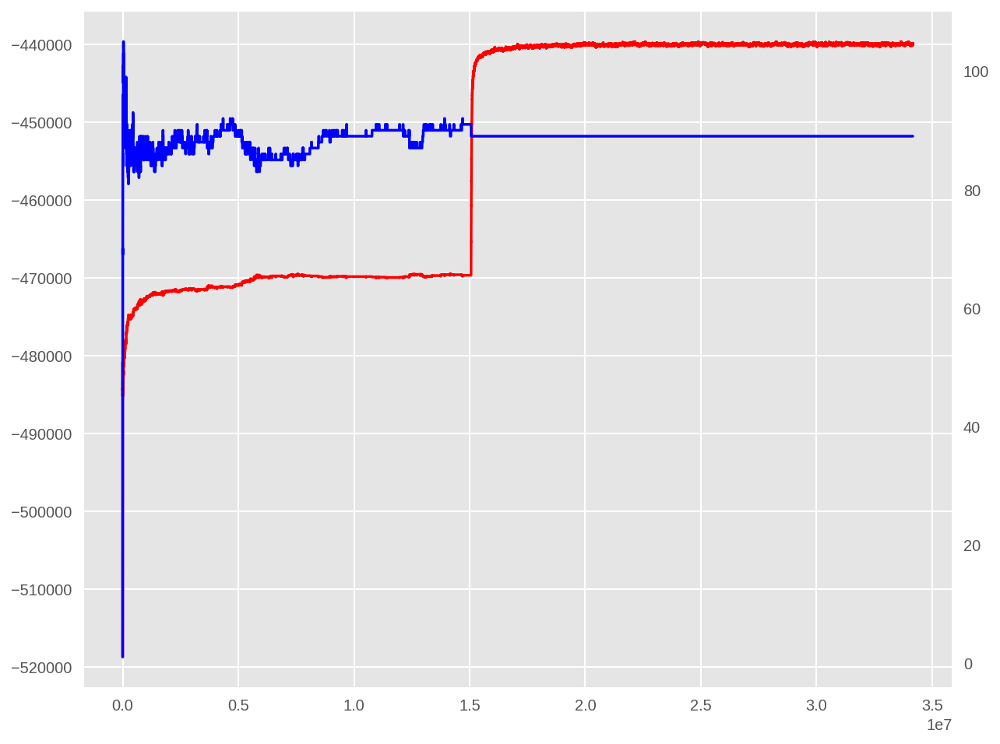

In [18]:
cv.clustering.plot_transition()   # this will be like: cv.clustering.dpmm.plot_transition() or cv.plot_dpmm_transition()